# Fast AI-Enabled Cell Tracking and Migration Analysis for High Throughput Drug Screening

## Autogenerated Report: EPIC Cell Migration Analysis
#### Website: https://github.com/AlphonsGwatimba/Fast-AI-enabled-cell-tracking-and-migration-analysis-for-high-throughput-drug-screening

In [1]:
import shutil
import sys
import os
import csv
from copy import deepcopy
from itertools import chain
import random as rd
from statistics import mean

import cv2

from IPython.display import Image, Video

import matplotlib.pyplot as plt
from matplotlib.pyplot import imshow 

import epic
from epic.analysis.cell_migration_analysis import (drnty_vs_euclid_dist,
                                                   metric_box_plots, metric_mthd_avgs,
                                                   smp_trks_le_dist, smp_trks_le_propn, 
                                                   smp_trks_len, traj_plots)
from epic.analysis.cell_migration_metrics import MetricFactory
from epic.utils.cell_migration import detect_leading_edges
from epic.utils.file_processing import (load_imagej_tracks, load_imgs,
                                        load_motc_dets, load_motc_tracks,
                                        save_imgs, save_motc_tracks, save_video,
                                        video_reshape)
from epic.utils.image_processing import draw_bounding_boxes, draw_leading_edges, draw_tracks
from epic.utils.misc import create_tracklets

import scipy

In [2]:
# preconfiguration
plt.rcParams['figure.figsize'] = [8, 6]
plt.rcParams['figure.dpi'] = 100
rd.seed(0)
VID_FILENAME = 'video'

In [3]:
# start
cwd = os.getcwd()
print(f'Running notebook in directory: {cwd}')

Running notebook in directory: C:\Users\Alphons\OneDrive\Documents\tracking\epic_dataset\Accelerated_B5\Analysis


## Image Series

In [4]:
# load images
motchallenge_img_dir = os.path.join(cwd, '..', 'img1')
img_dir = (motchallenge_img_dir if os.path.isdir(motchallenge_img_dir) else 
           os.path.join(cwd, '..'))
assert os.path.isdir(img_dir), f'Image directory {img_dir} could not be found.'
imgs = load_imgs(img_dir) 
assert len(imgs) > 1, 'Raw image series shorter than 2 frames.'
print(f'Loaded {len(imgs)} images.')

Loaded 26 images.


In [5]:
for i, img in enumerate(imgs, start=1):
    print(f'Image {i}: {img[0]}')

Image 1: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_13h30m.tif
Image 2: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_14h00m.tif
Image 3: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_14h30m.tif
Image 4: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_15h00m.tif
Image 5: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_15h30m.tif
Image 6: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_16h00m.tif
Image 7: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_16h30m.tif
Image 8: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_17h00m.tif
Image 9: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_17h30m.tif
Image 10: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_18h00m.tif
Image 11: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_18h30m.tif
Image 12: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_19h00m.tif
Image 13: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_19h30m.tif
Image 14: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_20h00m.tif
Image 15: 141130_NuLi-1 cell tracer_B5_1_2014y11m30d_20h30m.tif
Image 16: 141130_NuLi-1 cell tracer_B5_1_2014y11m

In [6]:
# show image series
output_dir = os.path.join(cwd, 'Raw_Image_Series')
if os.path.isdir(output_dir):
    shutil.rmtree(output_dir)
os.mkdir(output_dir)
save_imgs(imgs, output_dir)
raw_vid = os.path.join(output_dir, VID_FILENAME)
save_video(imgs, raw_vid)
raw_vid +=  epic.VID_FILE_EXT
dsp_wdh, dsp_hgt = video_reshape(raw_vid, 500)
Video(raw_vid, embed=True, width=dsp_wdh, height=dsp_hgt, html_attributes='controls loop autoplay')

## Cell Detections

In [7]:
# PARAMETER - None OR (> 0 AND <= 1)
dets_min_score = 0.99  # only load detections with this minimum confidence score

In [8]:
# load detections
motc_dets_file = os.path.join(os.getcwd(), '..', epic.DETECTIONS_DIR_NAME, 
                              epic.MOTC_DETS_FILENAME)
assert os.path.isfile(motc_dets_file), f'MOTC detections file {motc_dets_file} could not be found.'
dets = load_motc_dets(motc_dets_file, dets_min_score)
assert len(dets) > 1, 'Detections found in less than 2 frames.'
num_frames = min(len(imgs), len(dets))
imgs, dets = imgs[0: num_frames], dets[0: num_frames]
dets = create_tracklets(dets, imgs)
print(f'Loaded {len(list(chain.from_iterable(list(dets))))} detections.')

Loaded 55389 detections.


In [9]:
num_dets = []
for i, ds in enumerate(dets, start=1):
    num_dets.append(len(ds))
    print(f'Image {i} contains {len(ds)} detections')
print(f'\nAverage number of detections per image: {round(mean(num_dets))}')

Image 1 contains 2295 detections
Image 2 contains 2250 detections
Image 3 contains 2243 detections
Image 4 contains 2283 detections
Image 5 contains 2237 detections
Image 6 contains 2277 detections
Image 7 contains 2238 detections
Image 8 contains 2267 detections
Image 9 contains 2296 detections
Image 10 contains 2268 detections
Image 11 contains 2286 detections
Image 12 contains 2233 detections
Image 13 contains 2258 detections
Image 14 contains 2273 detections
Image 15 contains 2358 detections
Image 16 contains 2293 detections
Image 17 contains 2331 detections
Image 18 contains 2329 detections
Image 19 contains 2335 detections
Image 20 contains 2359 detections
Image 21 contains 2367 detections
Image 22 contains 2422 detections
Image 23 contains 2399 detections
Image 24 contains 2492 detections

Average number of detections per image: 2308


In [10]:
# show detections
dets_imgs = deepcopy(imgs)
for ds in dets:
    draw_bounding_boxes(ds, dets_imgs, colour=(0, 0, 255))
output_dir = os.path.join(cwd, 'All_Detections')
if os.path.isdir(output_dir):
    shutil.rmtree(output_dir)
os.mkdir(output_dir)
save_imgs(dets_imgs, output_dir)
dets_vid = os.path.join(output_dir, VID_FILENAME)
save_video(dets_imgs, dets_vid)
dets_vid += epic.VID_FILE_EXT
dsp_wdh, dsp_hgt = video_reshape(dets_vid, 500)
Video(dets_vid, embed=True, width=dsp_wdh, height=dsp_hgt, html_attributes='controls loop autoplay')

## Leading Edges

In [11]:
top_le, btm_le = detect_leading_edges(imgs[0][1], dets[0])
print('Detected top and bottom leading edges, in first image '
      f'of series, at y-positions {top_le} and {btm_le} (px.) '
      'respectively.')

Detected top and bottom leading edges, in first image of series, at y-positions 519 and 1127 (px.) respectively.


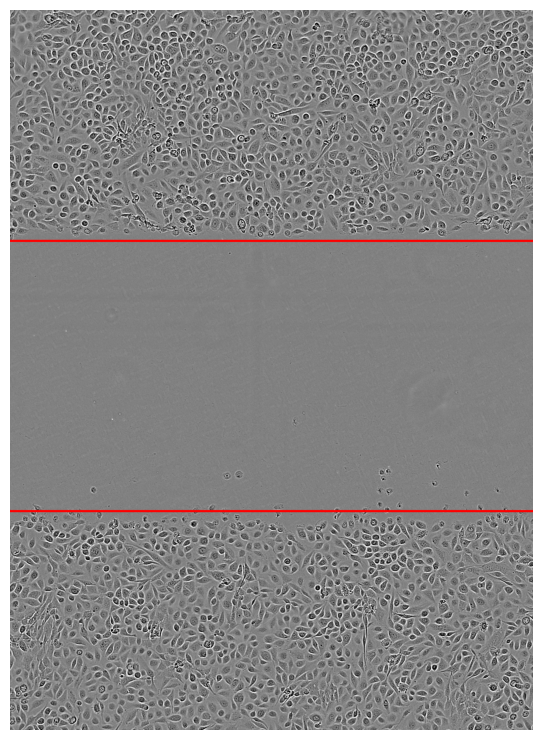

In [12]:
# show leading edges
first_img = imgs[0][1].copy()
draw_leading_edges(first_img, (top_le, btm_le), thickness=4)
fig = plt.figure(figsize=(12,8))
plt.subplots_adjust(left=0.01, right=0.5, top=1, bottom=0.1)
plt.axis('off')
cv2.imwrite('leading_edges.png', first_img)
first_img = cv2.cvtColor(first_img, cv2.COLOR_BGR2RGB)
imshow(first_img)

## Cell Tracks

In [13]:
# load tracks
motc_tracks_file = os.path.join(os.getcwd(), '..', epic.TRACKS_DIR_NAME, 
                                epic.MOTC_TRACKS_FILENAME)
assert os.path.isfile(motc_tracks_file), f'MOTC tracks file {motc_tracks_file} could not be found.'
auto_tracks = load_motc_tracks(motc_tracks_file)
auto_tracks = create_tracklets(auto_tracks, imgs, method='Automatic')
auto_tracks = list(chain.from_iterable(list(auto_tracks)))
for i, track in enumerate(auto_tracks):
    track.id = i
assert len(auto_tracks) > 0, 'No tracks loaded.'

print(f'Loaded {len(auto_tracks)} tracks.')

Loaded 4224 tracks.


In [14]:
track_lens, track_start_frames, track_end_frames = [], [], []
for track in auto_tracks:
    track_lens.append(track.num_dets)
    track_start_frames.append(track.start_frame)
    track_end_frames.append(track.end_frame)
    
print(f'Average length of tracks: {round(mean(track_lens))} frames')
print(f'Average starting frame of tracks: frame {round(mean(track_start_frames))}')
print(f'Average ending frame of tracks: frame {round(mean(track_end_frames))}')

Average length of tracks: 13 frames
Average starting frame of tracks: frame 7
Average ending frame of tracks: frame 19


In [15]:
# show tracks
tracks_imgs = deepcopy(imgs)
draw_tracks(auto_tracks, tracks_imgs)
output_dir = os.path.join(cwd, 'All_Tracks')
if os.path.isdir(output_dir):
    shutil.rmtree(output_dir)
os.mkdir(output_dir)
save_imgs(tracks_imgs, output_dir)
tracks_vid = os.path.join(output_dir, VID_FILENAME)
save_video(tracks_imgs, tracks_vid)
tracks_vid += epic.VID_FILE_EXT
dsp_wdh, dsp_hgt = video_reshape(tracks_vid, 500)
Video(tracks_vid, embed=True, width=dsp_wdh, height=dsp_hgt, html_attributes='controls loop autoplay')

## Sampled Cell Tracks

In [ ]:
# PARAMETER - 'euclidean_distance' OR 'accumulated_distance' OR 'velocity'
#             OR 'directionality' OR 'y_forward_motion_index' 
#             OR 'endpoint_angle'
# cell migration metrics to compute
metric_names = ['euclidean_distance', 'accumulated_distance', 'velocity',
                'directionality', 'y_forward_motion_index',
                'endpoint_angle']

In [29]:
# automated cell track params
tracks_start_frame = 1
tracks_end_frame = 22
dist_btm_le = 50
dist_top_le = 50
num_btm_le_dets = 10
num_top_le_dets = 10
propn = 0.33

In [30]:
# sample automated cell tracks
print('Sampled Automated Tracks')
rd.shuffle(auto_tracks)
sampled_auto_tracks = smp_trks_len(auto_tracks, tracks_end_frame, tracks_start_frame)
assert len(sampled_auto_tracks) > 0, 'Could not sample any tracks meeting criteria.'
print('Number of tracks longer than '
      f'{tracks_end_frame - tracks_start_frame} frames: '
      f'{len(sampled_auto_tracks)}')
sampled_auto_tracks = smp_trks_le_dist(sampled_auto_tracks, (top_le, btm_le), dist_btm_le, dist_top_le, 
                               num_btm_le_dets, num_top_le_dets)
# sampled_auto_tracks = smp_trks_le_propn(sampled_auto_tracks, (top_le, btm_le), propn, img_hgt,
#                                 num_btm_le_dets, num_top_le_dets)
assert len(sampled_auto_tracks) > 0, 'Could not sample any tracks meeting criteria.'
print(f'Number of sampled cells: {len(sampled_auto_tracks)}')

Sampled Automated Tracks
Number of tracks longer than 21 frames: 1398
Number of sampled cells: 20


In [33]:
sequence_name = cwd.split(os.path.sep)[-2]  # TODO Fix when missing
imagej_tracks_file = os.path.join(cwd, '..', 'manual_tracks.csv')
tracks_start_frame = 1
tracks_end_frame = 22
dist_btm_le = 175
dist_top_le = 175
num_btm_le_dets = 20
num_top_le_dets = 20

In [21]:
# sample manual cell tracks
print('Sampled Manual Tracks')
man_tracks = load_imagej_tracks(imagej_tracks_file)
rd.shuffle(man_tracks)
sampled_man_tracks = smp_trks_len(man_tracks, tracks_end_frame, tracks_start_frame)
assert len(sampled_man_tracks) > 0, 'Could not sample any tracks meeting criteria.'
print('Number of tracks longer than '
      f'{tracks_end_frame - tracks_start_frame} frames: '
      f'{len(sampled_man_tracks)}')
sampled_man_tracks = smp_trks_le_dist(sampled_man_tracks, (top_le, btm_le), dist_btm_le, dist_top_le, 
                               num_btm_le_dets, num_top_le_dets)
# sampled_man_tracks = smp_trks_le_propn(sampled_man_tracks, (top_le, btm_le), propn, img_hgt,
#                                 num_btm_le_dets, num_top_le_dets)
assert len(sampled_man_tracks) > 0, 'Could not sample any tracks meeting criteria.'
print(f'Number of sampled cells: {len(sampled_man_tracks)}')

Sampled Manual Tracks
Number of tracks longer than 21 frames: 20
Number of sampled cells: 20


In [ ]:
# visualize sampled automated cell tracks
tracks_imgs = deepcopy(imgs)
draw_tracks(sampled_auto_tracks, tracks_imgs)
output_dir = os.path.join(cwd, 'Sampled_Tracks')
if os.path.isdir(output_dir):
    shutil.rmtree(output_dir)
os.mkdir(output_dir)
save_imgs(tracks_imgs, output_dir)
tracks_vid = os.path.join(output_dir, VID_FILENAME)
save_video(tracks_imgs, tracks_vid)
tracks_vid += epic.VID_FILE_EXT
dsp_wdh, dsp_hgt = video_reshape(tracks_vid, 500)
Video(tracks_vid, embed=True, width=dsp_wdh, height=dsp_hgt, html_attributes='controls loop autoplay')

## Cell Migration Metrics

In [ ]:
metric_filename = 'cell_migration_metrics.csv'
p_values_filename = 'p_values.csv'

In [ ]:
# compute automated cell track metrics
m_fcty = MetricFactory()
auto_results = [m_fcty.get_metric(m, 'Automated') for m in metric_names]
img_hgt = imgs[0][1].shape[0]
img_cen_y = imgs[0][1].shape[0] / 2
tracks, results = [], []
for auto_result in auto_results:
    for track in sampled_auto_tracks:
        auto_result.compute_metric(track, store=True, first_frame=tracks_start_frame, 
                                   end_frame=tracks_end_frame, img_cen_y=img_cen_y)
tracks.append(sampled_auto_tracks)
results.append(auto_results)

In [ ]:
# compute manual cell track metrics
man_results = [m_fcty.get_metric(m, 'Manual') for m in metric_names]
for man_result in man_results:
    for track in sampled_man_tracks:
        man_result.compute_metric(track, store=True, first_frame=tracks_start_frame, 
                                   end_frame=tracks_end_frame, img_cen_y=img_cen_y)
tracks.append(sampled_man_tracks)
results.append(man_results)

In [22]:
# save metrics
exp, rep = sequence_name.split('_')
with open(metric_filename, 'w', newline='') as csvfile:
    metrics = []
    for r in results[0]:
        metrics.append(r.name)
    fieldnames = ['Experiment', 'Replicate', 'Method'] + metrics
    writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
    writer.writeheader()
    row = {}
    for rs in results:
        row['Experiment'] = exp
        row['Replicate'] = rep
        row['Method'] = rs[0].method
        num_trks = len(rs[0].stored)
        num_ms = len(rs)
        for trk_num in range(0, num_trks):
            for m_num in range(0, num_ms):
                row[metrics[m_num]] = rs[m_num].stored[trk_num]
            writer.writerow(row)

In [23]:
# print metrics, p-values and save p-values
with open(p_values_filename, 'w', newline='') as csvfile:
    fieldnames = ['Experiment', 'Replicate', 'Cell Migration Metric', 'P-Value']
    writer = csv.DictWriter(csvfile, fieldnames=fieldnames)
    writer.writeheader()
    row = {}
    row['Experiment'] = exp
    row['Replicate'] = rep
    for i, rs in enumerate(zip(*results)):
        print(f'Metric: {rs[0].name}')
        row['Cell Migration Metric'] = rs[0].name
        raw = []
        for r in rs:
            print(f'{r.method} average: {round(mean(r.stored), 2)} {r.units}')
            raw.append(r.stored)
        row['P-Value'] = scipy.stats.ttest_ind(raw[0], raw[1])[1]
        print(f'P-Value: {round(row["P-Value"], 2)}')
        writer.writerow(row)
        print()

Metric: Euclidean Distance
Automated average: 191.16 Micrometres (um)
Manual average: 178.67 Micrometres (um)

Metric: Accumulated Distance
Automated average: 404.42 Micrometres (um)
Manual average: 309.53 Micrometres (um)

Metric: Velocity
Automated average: 18.21 Micrometres/Hour (um/hr)
Manual average: 17.02 Micrometres/Hour (um/hr)

Metric: Directionality
Automated average: 0.47 Arbitrary Units (AU)
Manual average: 0.51 Arbitrary Units (AU)

Metric: Y - Forward Motion Index
Automated average: 0.12 Arbitrary Units (AU)
Manual average: 0.7 Arbitrary Units (AU)

Metric: End Point Angle
Automated average: 91.41 Degrees (Deg)
Manual average: 100.16 Degrees (Deg)



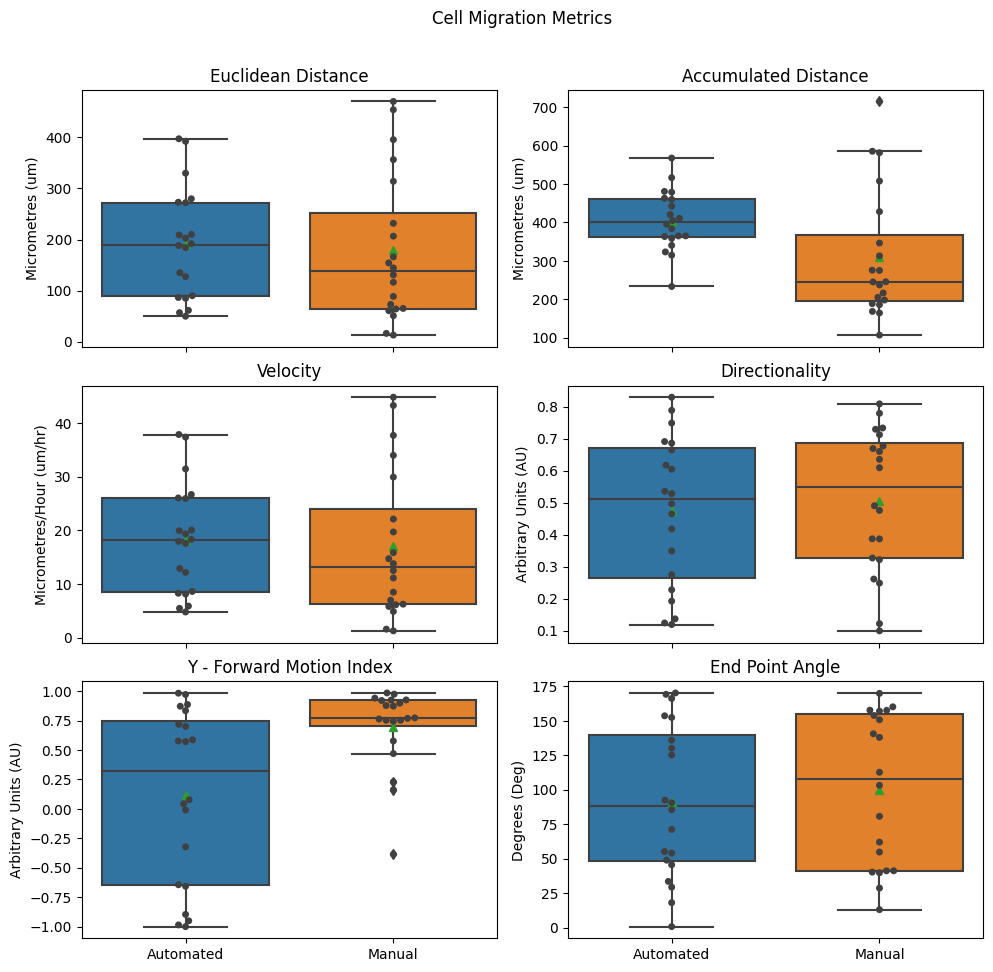

In [24]:
# plots
metric_box_plots(*results)
plt.subplots_adjust(top=0.9)
plt.show()

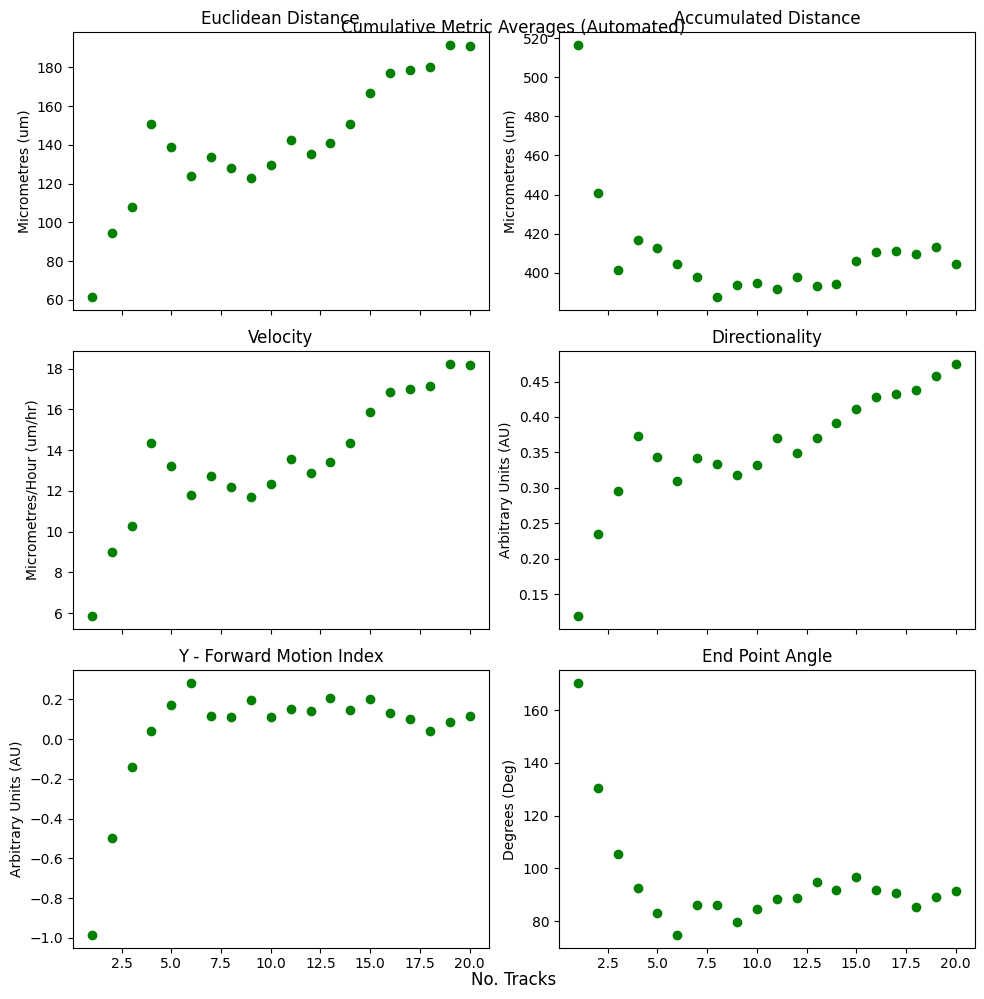

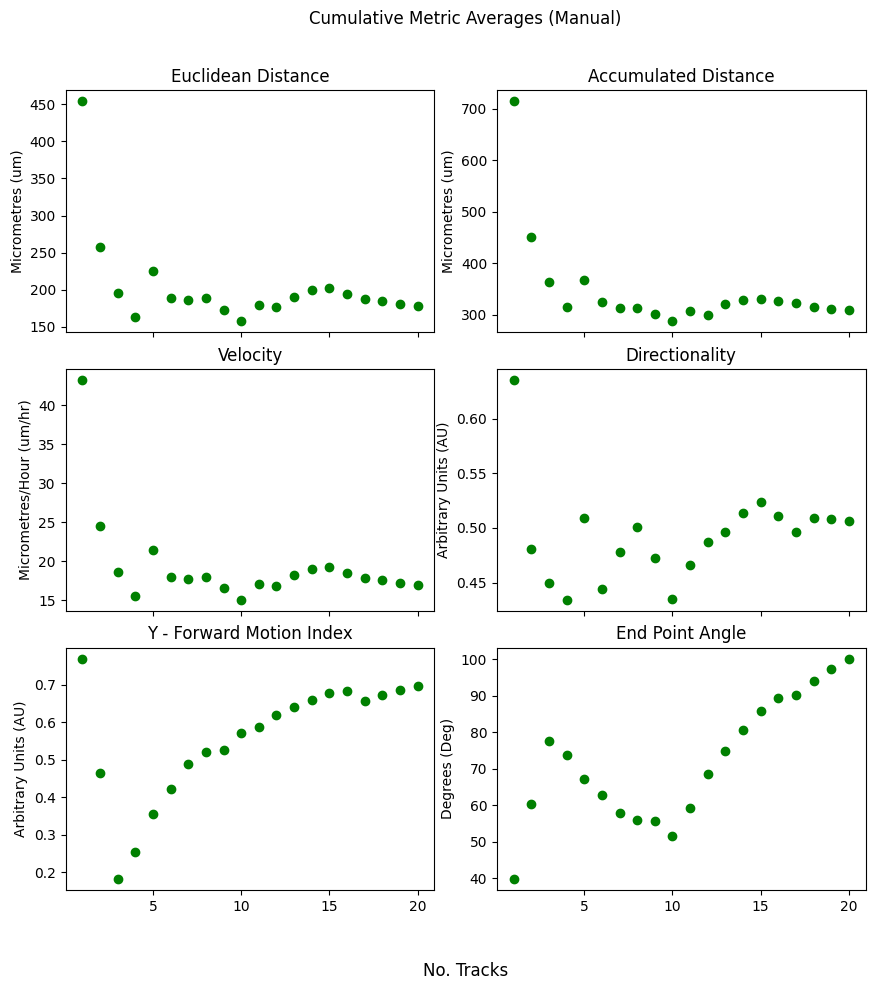

In [25]:
metric_mthd_avgs(*results)
plt.subplots_adjust(top=0.9, right=0.9, bottom=0.1, left=0.1)
plt.show()

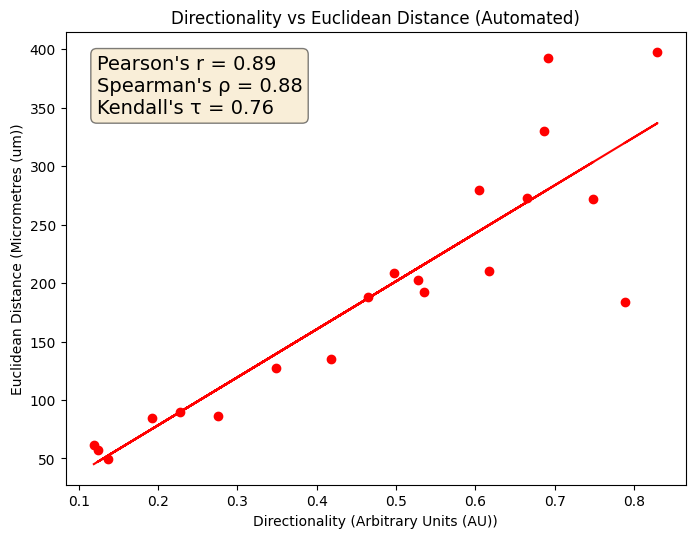

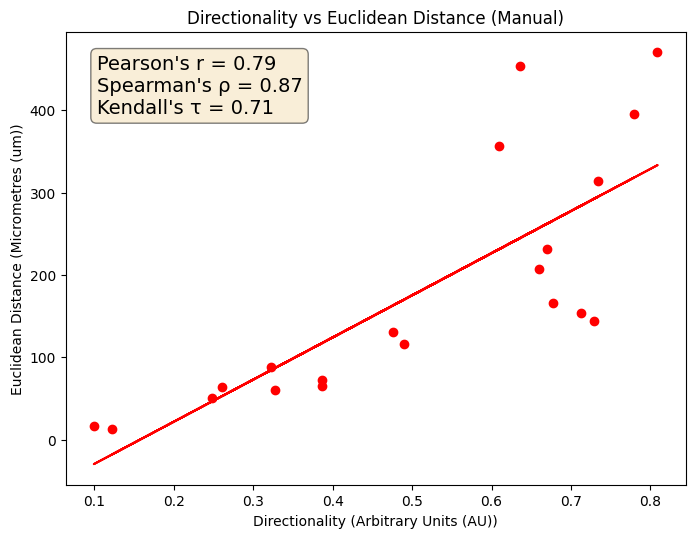

In [26]:
drnty_vs_euclid_dist(*results)
plt.show()

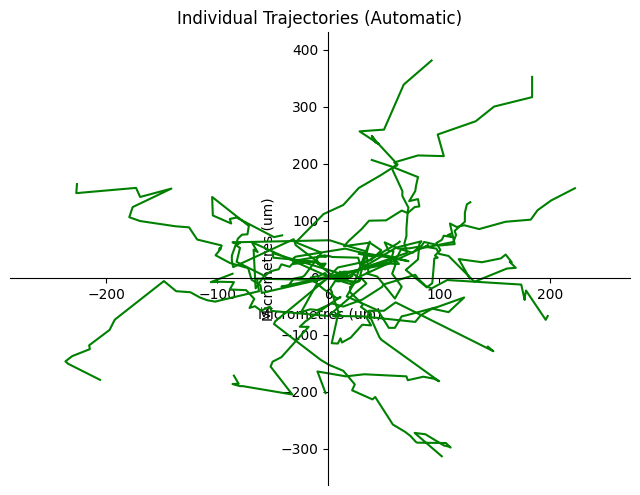

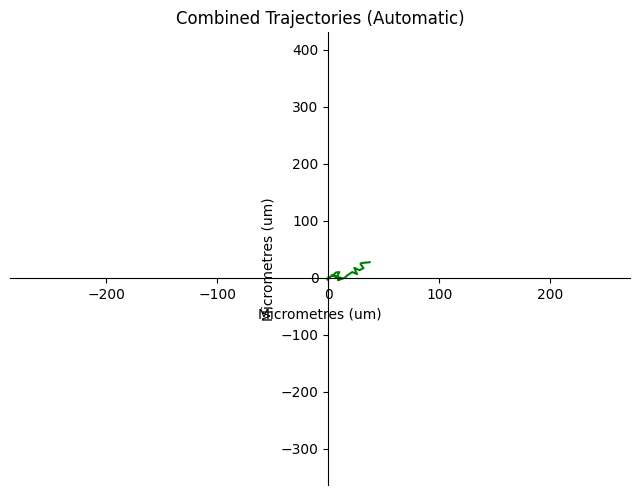

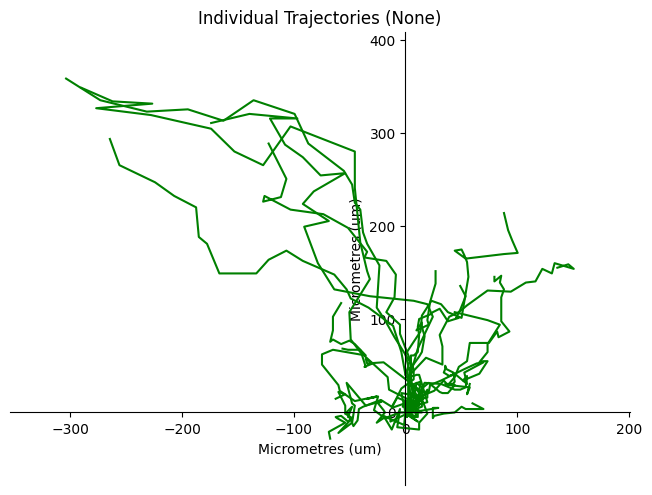

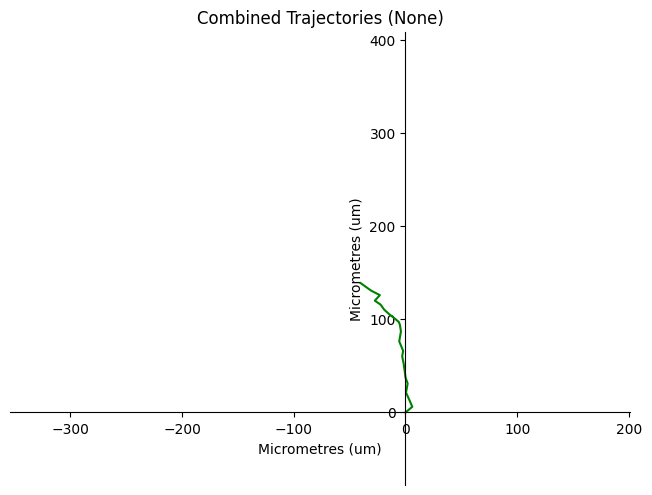

In [27]:
traj_plots(img_cen_y, *tracks, length=None)
plt.show()